# Train a Lightweight Phoneme-Based TTS Model and Evaluate Audio Similarity

In [ ]:
import warnings

# Suppress specific warnings
warnings.filterwarnings("ignore", category=UserWarning)  # Ignores UserWarnings
warnings.filterwarnings("ignore", category=FutureWarning)  # Ignores FutureWarnings

In [ ]:
import pandas as pd  # Import the pandas library for data manipulation
import os            # Import os for interacting with the operating system (e.g., file paths)

# Load the metadata CSV file containing 'wav_file' and 'transcript' columns
df = pd.read_csv('Metadata.csv')  # Assumes the file is in the same directory as the script

# Display the first few rows of the DataFrame to verify it loaded correctly
print(df.head())  # This helps confirm column names and sample contents


                                   wav_file  \
0  13b2068a-2def-4f69-b4ba-168c4da30498.wav   
1  f3429b2a-fcb2-4073-b17b-0529840bda6c.wav   
2  7086ebc0-3f6d-4947-ab2b-0b9289a42978.wav   
3  97311a8e-52a5-4b9e-be46-3ba6a29c39aa.wav   
4  81827e62-9599-4b47-8b1d-092e58677b34.wav   

                                          transcript  
0  I invite you to embark on a profound journey a...  
1  Meditation on the White Light This technique i...  
2  Meditation on the White Light This technique i...  
3  Meditation on the White Light This technique i...  
4  positive affirmations for me My business is co...  


In [ ]:
df.columns

Index(['wav_file', 'transcript'], dtype='object')

In [ ]:
# Construct full audio path by appending the 'wav_file' name to the 'audio/' directory
# This is useful if the audio files are stored in a subfolder named 'audio'
df['audio_path'] = df['wav_file'].apply(lambda x: os.path.join("audio", x))

# After this step, each row in the new 'audio_path' column contains the complete path to the corresponding audio file
# Example: '13b2068a...wav' becomes 'audio/13b2068a...wav'


In [ ]:
# Import the KPipeline class from Kokoro, which is used for synthesizing speech from text or phonemes
from kokoro import KPipeline

# Used to display audio playback widgets directly in Jupyter Notebooks
from IPython.display import Audio, display

# Library to save audio data to WAV files
import soundfile as sf

# For interacting with the operating system (e.g., managing file paths and directories)
import os


# Initialize the Kokoro TTS pipeline for a specific language
#  'a is for american eng'
pipeline = KPipeline(lang_code='a', repo_id='hexgrad/Kokoro-82M')

In [ ]:
# Create a directory named "predicted_audio" if it doesn't already exist
# This is where the synthesized (predicted) audio files will be saved
os.makedirs("predicted_audio", exist_ok=True)


In [ ]:
# Loop through the first 3 samples in the dataset for evaluation
for i, row in df.head(3).iterrows():
    text = row['transcript']  # Extract the transcript text

    # Generate audio from text using the specified voice ('af_heart')
    generator = pipeline(text, voice='af_heart')

    # Loop through the generated audio segments (if multiple are returned)
    for j, (_, _, audio) in enumerate(generator):
        # Define the filename for the predicted audio output
        file_name = f"predicted_audio/{i}_{j}.wav"

        # Save the generated audio to a WAV file at 24 kHz sample rate
        sf.write(file_name, audio, 24000)

        # Print confirmation and play the audio inside the notebook
        print(f"Saved: {file_name}")
        display(Audio(data=audio, rate=24000, autoplay=True))


Saved: predicted_audio/0_0.wav


Saved: predicted_audio/0_1.wav


Saved: predicted_audio/0_2.wav


Saved: predicted_audio/0_3.wav


Saved: predicted_audio/0_4.wav


Saved: predicted_audio/0_5.wav


Saved: predicted_audio/0_6.wav


Saved: predicted_audio/0_7.wav


Saved: predicted_audio/0_8.wav


Saved: predicted_audio/1_0.wav


Saved: predicted_audio/1_1.wav


Saved: predicted_audio/1_2.wav


Saved: predicted_audio/1_3.wav


Saved: predicted_audio/1_4.wav


Saved: predicted_audio/1_5.wav


Saved: predicted_audio/1_6.wav


Saved: predicted_audio/1_7.wav


Saved: predicted_audio/2_0.wav


Saved: predicted_audio/2_1.wav


Saved: predicted_audio/2_2.wav


Saved: predicted_audio/2_3.wav


Saved: predicted_audio/2_4.wav


Saved: predicted_audio/2_5.wav


Saved: predicted_audio/2_6.wav


Saved: predicted_audio/2_7.wav


Saved: predicted_audio/2_8.wav


In [ ]:
import numpy as np
import librosa
import scipy.spatial  # (Though unused here, this can be helpful for cosine or other similarity metrics)

# Function to compute similarity metrics between predicted and ground truth audio
def compute_similarity_metrics(pred_path, gt_path):
    # Load predicted and ground truth audio at a sample rate of 24kHz
    y_pred, _ = librosa.load(pred_path, sr=24000)
    y_true, _ = librosa.load(gt_path, sr=24000)

    # Truncate both signals to the same length to allow direct comparison
    min_len = min(len(y_pred), len(y_true))
    y_pred = y_pred[:min_len]
    y_true = y_true[:min_len]

    # L1 Loss (Mean Absolute Error)
    l1 = np.mean(np.abs(y_pred - y_true))

    # L2 Loss (Mean Squared Error)
    l2 = np.mean((y_pred - y_true)**2)

    return l1, l2

# Loop through the first 3 rows of the dataset to evaluate audio similarity
for i, row in df.head(3).iterrows():
    pred_path = f"predicted_audio/{i}_0.wav"  # Path to predicted audio
    gt_path = row["audio_path"]               # Path to actual (ground truth) audio

    # Compute L1 and L2 losses
    l1, l2 = compute_similarity_metrics(pred_path, gt_path)

    # Print the similarity results for each sample
    print(f"Sample {i} — L1: {l1:.4f}, L2: {l2:.4f}")


Sample 0 — L1: 0.0385, L2: 0.0033
Sample 1 — L1: 0.0381, L2: 0.0032
Sample 2 — L1: 0.0381, L2: 0.0033


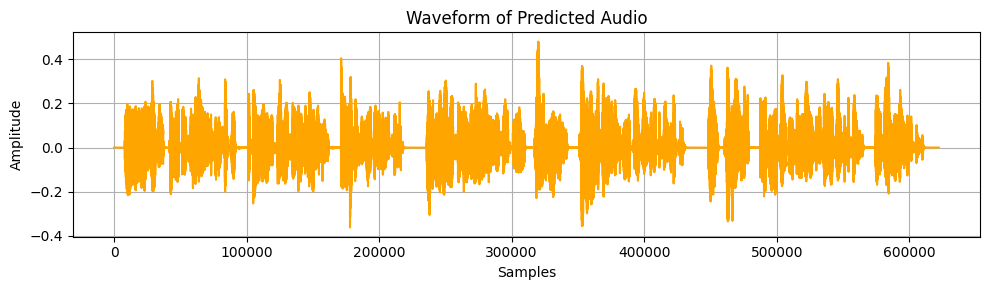

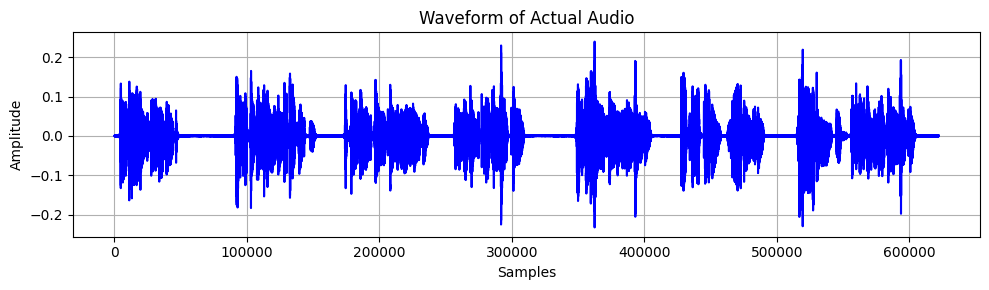

In [ ]:
import librosa
import matplotlib.pyplot as plt

# Load predicted audio using librosa with a sample rate of 24000 Hz
y, sr = librosa.load(pred_path, sr=24000)

# Load ground truth audio using the same sample rate for consistency
y1, sr1 = librosa.load(gt_path, sr=24000)

# Truncate both signals to the same length to ensure proper comparison
min_len = min(len(y), len(y1))
y = y[:min_len]
y1 = y1[:min_len]

# Plot the waveform of the predicted audio
plt.figure(figsize=(10, 3))
plt.plot(y, label="Predicted", color='orange')
plt.title("Waveform of Predicted Audio")
plt.xlabel("Samples")
plt.ylabel("Amplitude")
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot the waveform of the ground truth (actual) audio
plt.figure(figsize=(10, 3))
plt.plot(y1, label="Ground Truth", color='blue')
plt.title("Waveform of Actual Audio")
plt.xlabel("Samples")
plt.ylabel("Amplitude")
plt.grid(True)
plt.tight_layout()
plt.show()
